#Mounting Drive 

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


#Feature Extraction

In [ ]:
from skimage.feature import hog
from skimage.io import imread
import joblib
import glob
import os
import cv2

pos_im_path = '/content/drive/MyDrive/Data/persons/pos'
neg_im_path = '/content/drive/MyDrive/Data/persons/neg'
min_wdw_sz = [64, 128]
step_size = [10,10]#sample image size
orientations = 9
pixels_per_cell = [6,6]
cells_per_block = [2, 2]
visualize = False
normalize = True
pos_feat_ph = '/content/drive/MyDrive/Data/features/pos_mod'
neg_feat_ph = '/content/drive/MyDrive/Data/features/neg_mod'
model_path = '/content/drive/MyDrive/Data/models'
threshold = .3


    
def extract_features():
    des_type = 'HOG'

    # If feature directories don't exist, create them
    if not os.path.isdir(pos_feat_ph):
        os.makedirs(pos_feat_ph)

    # If feature directories don't exist, create them
    if not os.path.isdir(neg_feat_ph):
        os.makedirs(neg_feat_ph)

    print("Calculating the descriptors for the positive samples and saving them")
    for im_path in glob.glob(os.path.join(pos_im_path, "*")):
        #print im_path
        
        image = cv2.imread(im_path,0)
        if des_type == "HOG":
            fd =hog(image, orientations=9, pixels_per_cell=(6, 6), cells_per_block=(2, 2), block_norm='L1',visualize=True, transform_sqrt=False, feature_vector=True)
        fd_name = os.path.split(im_path)[1].split(".")[0] + ".feat"
        fd_path = os.path.join(pos_feat_ph, fd_name)
        joblib.dump(fd, fd_path)
    print("Positive features saved in {}".format(pos_feat_ph))

    print("Calculating the descriptors for the negative samples and saving them")
    for im_path in glob.glob(os.path.join(neg_im_path, "*")):
        im = cv2.imread(im_path,0)
        if des_type == "HOG":
            fd =hog(im, orientations=9, pixels_per_cell=(6, 6), cells_per_block=(2, 2), block_norm='L1',visualize=True, transform_sqrt=False, feature_vector=True)
        fd_name = os.path.split(im_path)[1].split(".")[0] + ".feat"
        fd_path = os.path.join(neg_feat_ph, fd_name)
    
        joblib.dump(fd, fd_path)
    print("Negative features saved in {}".format(neg_feat_ph))

    print("Completed calculating features from training images")

if __name__=='__main__':
    extract_features()


Calculating the descriptors for the positive samples and saving them
Positive features saved in /content/drive/MyDrive/Data/features/pos_mod
Calculating the descriptors for the negative samples and saving them
Negative features saved in /content/drive/MyDrive/Data/features/neg_mod
Completed calculating features from training images


#Training Model

In [ ]:
import glob
import os
from skimage.feature import hog
import numpy as np
import cv2
from sklearn import svm
import joblib

#import config
pos_im_path = '/content/drive/MyDrive/Data/persons/pos'
neg_im_path = '/content/drive/MyDrive/Data/persons/neg'


samples = []
labels = []    

# Get positive samples
for filename in glob.glob(os.path.join(pos_im_path, '*.png')):
    img = cv2.imread(filename, 0)
    resimg = cv2.resize(img, (320,240))
    hist =  hog(resimg, orientations=9, pixels_per_cell=(6, 6),cells_per_block=(2, 2),block_norm='L1', visualize=False,transform_sqrt=False,feature_vector=True)
    samples.append(hist)
    labels.append(1)

# Get negative samples
for filename in glob.glob(os.path.join(neg_im_path, '*.jpg')):
    img = cv2.imread(filename, 0)
    resimg = cv2.resize(img,(320,240))
    hist =  hog(resimg, orientations=9, pixels_per_cell=(6, 6),cells_per_block=(2, 2),block_norm='L1', visualize=False,transform_sqrt=False,feature_vector=True)
    samples.append(hist)
    labels.append(0)

# Convert objects to Numpy Objects

samples = np.float32(samples)
labels = np.array(labels)


# Shuffle Samples
rand = np.random.RandomState(321)
shuffle = rand.permutation(len(samples))
samples = samples[shuffle]
labels = labels[shuffle]    
# Create SVM classifier
svm = cv2.ml.SVM_create()
svm.setType(cv2.ml.SVM_C_SVC)
svm.setKernel(cv2.ml.SVM_RBF) # cv2.ml.SVM_LINEAR
svm.setGamma(5.383)
svm.setC(2.67)

# Train the SVM Model
svm.train(samples, cv2.ml.ROW_SAMPLE, labels)

#Saving the SVM Model in svm.xml file
print("Saving model to models/svm.xml")
svm.save('/content/drive/MyDrive/Data/models/svm.xml')

#Files_path

In [ ]:
class_name_path = "/content/drive/MyDrive/Data/models/model/class.names"
model_weight_path = "/content/drive/MyDrive/Data/models/model/model.weights"
model_cfb_path = "/content/drive/MyDrive/Data/models/model/model.cfb"
svm_model_path = "/content/drive/MyDrive/Data/models/svm.xml"

#Model fire and Human Detection

##Input: Video File

In [ ]:
input_video_file_path = "/content/drive/MyDrive/Data/3.webm"

Warning!! Human and Fire is detected :high priority region


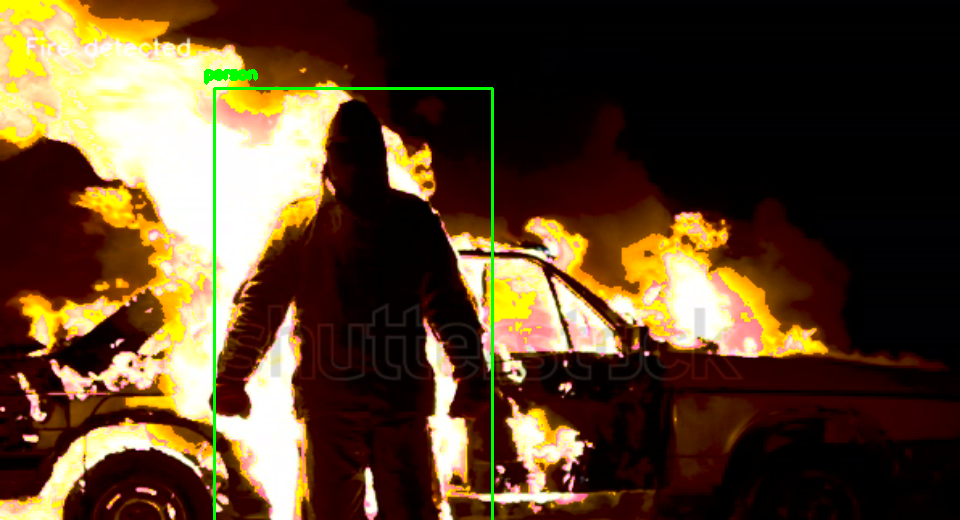

Warning!! Human and Fire is detected :high priority region


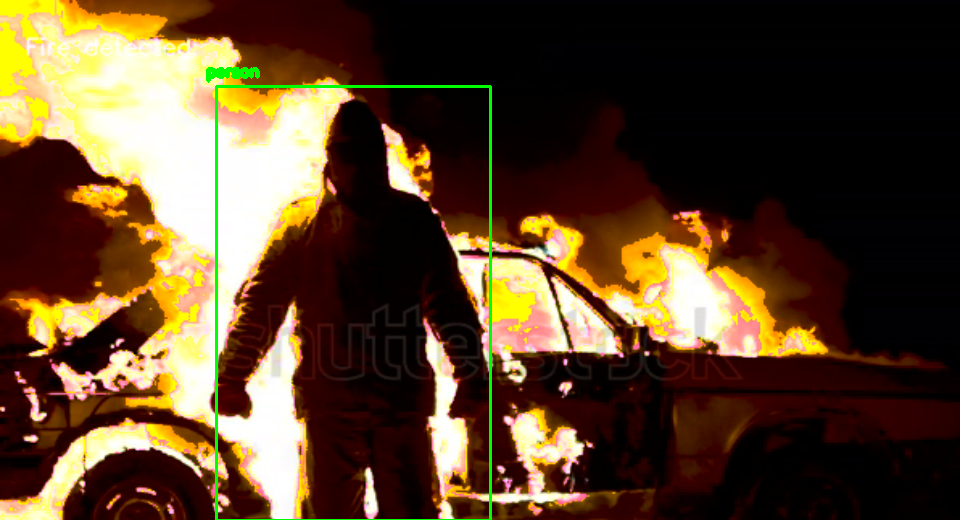

Warning!! Human and Fire is detected :high priority region


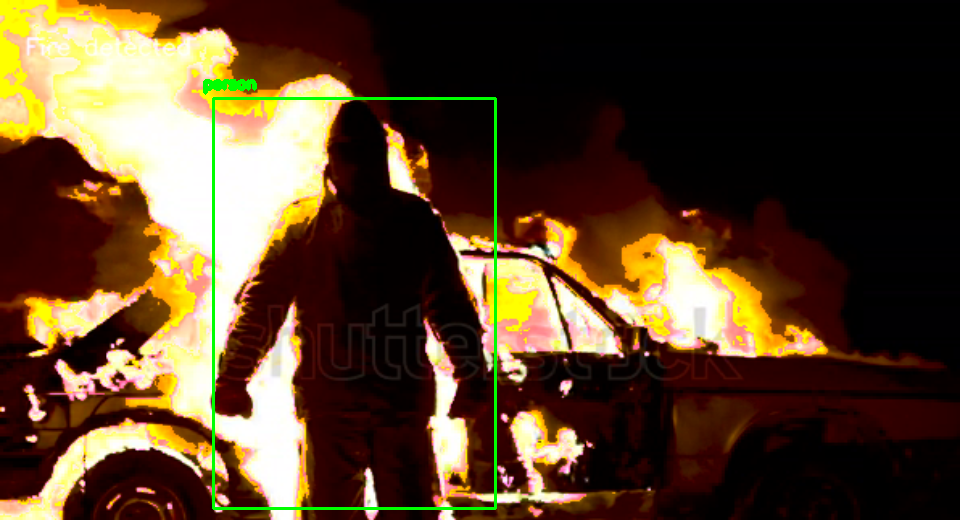

Warning!! Human and Fire is detected :high priority region


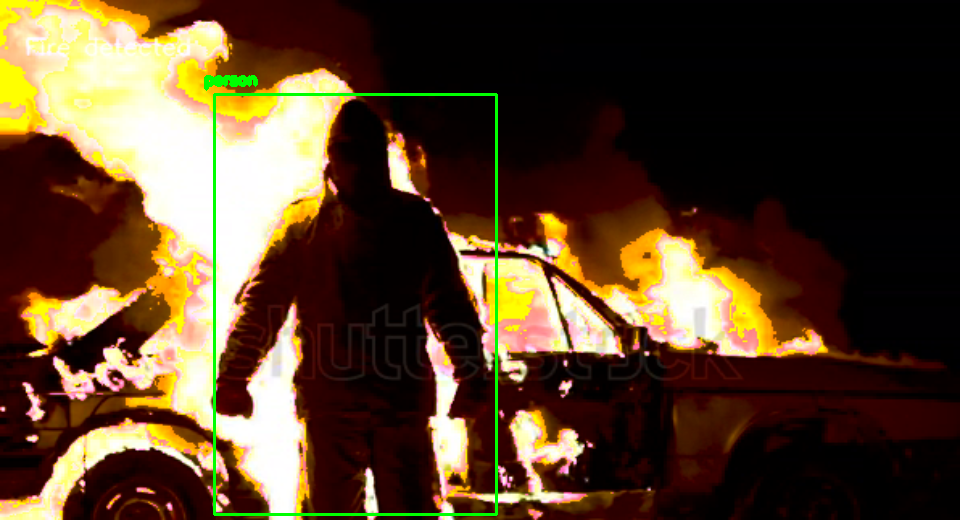

Warning!! Human and Fire is detected :high priority region


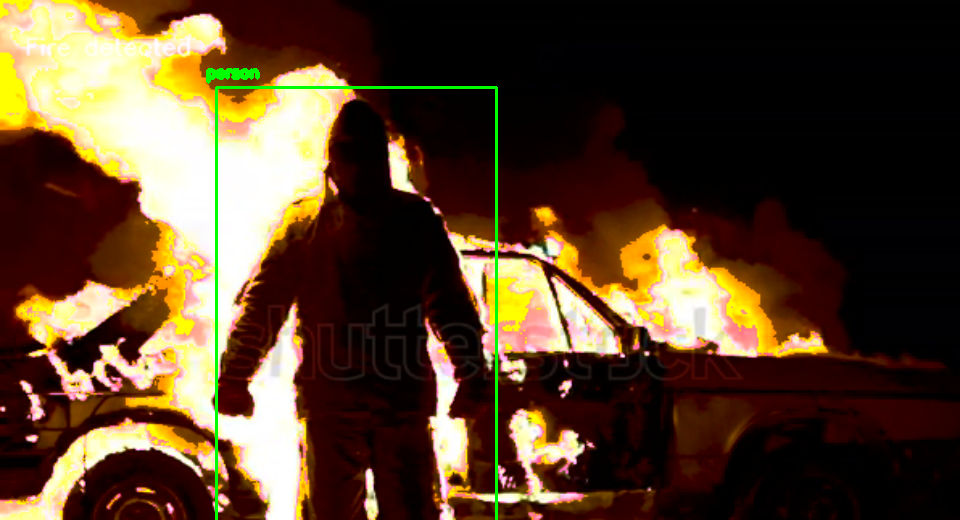

Warning!! Human and Fire is detected :high priority region


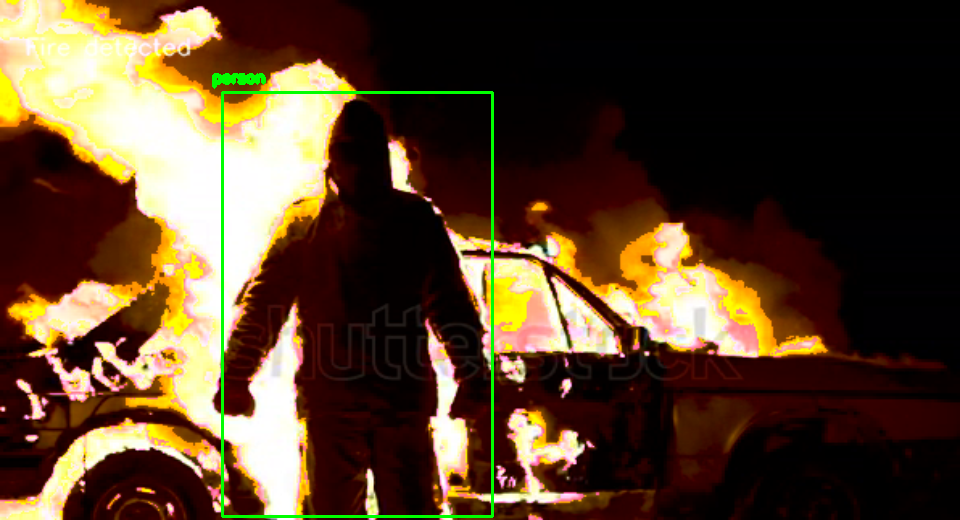

Warning!! Human and Fire is detected :high priority region


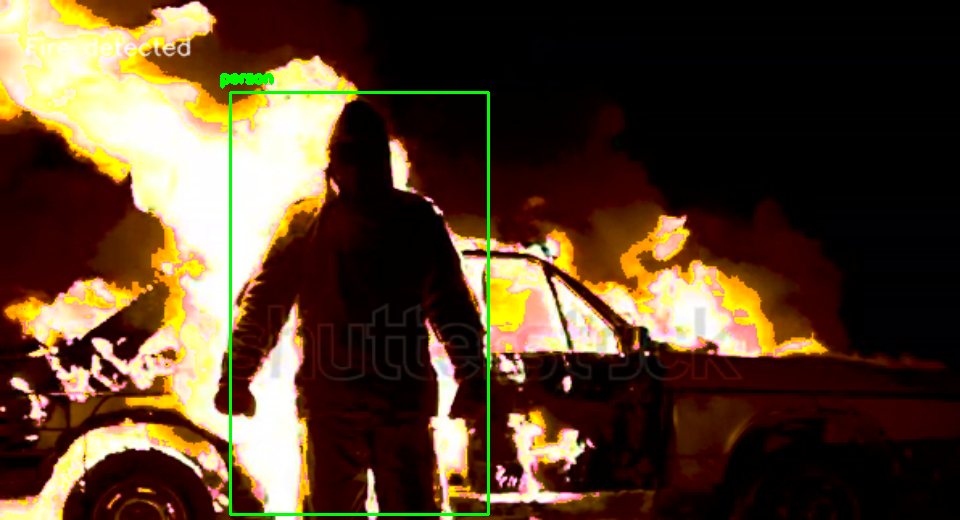

Warning!! Human and Fire is detected :high priority region


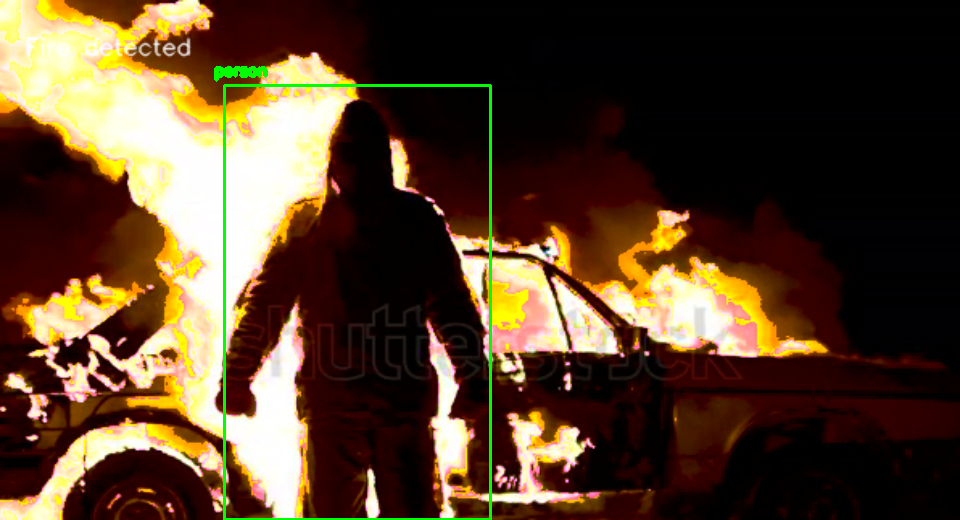

Warning!! Human and Fire is detected :high priority region


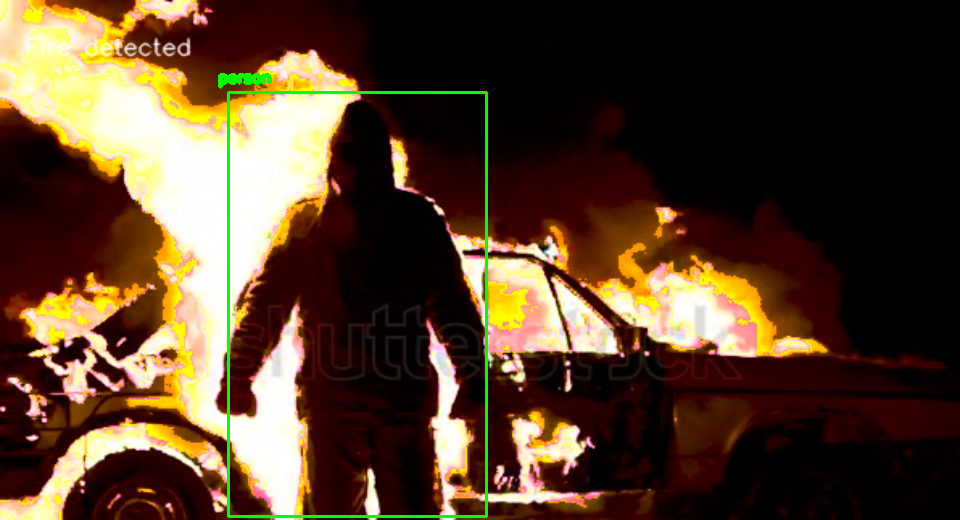

Warning!! Human and Fire is detected :high priority region


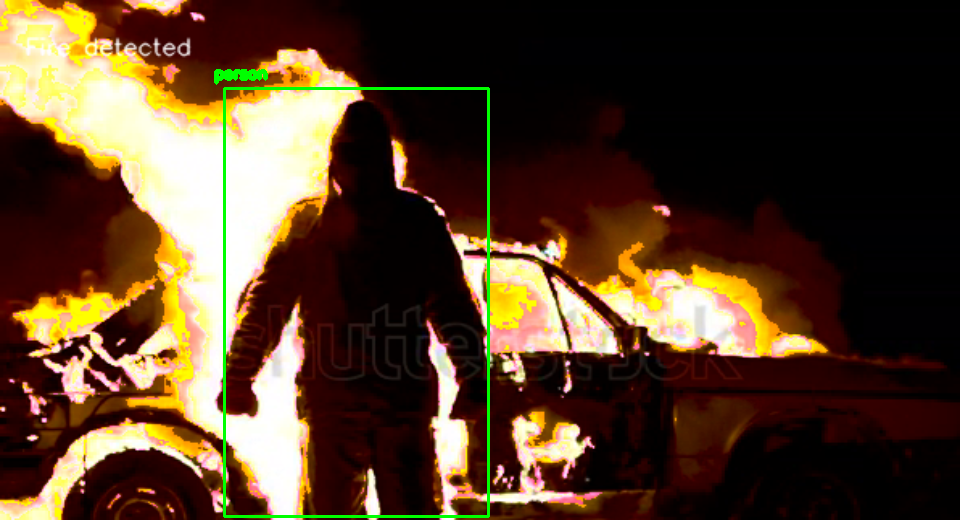

Warning!! Human and Fire is detected :high priority region


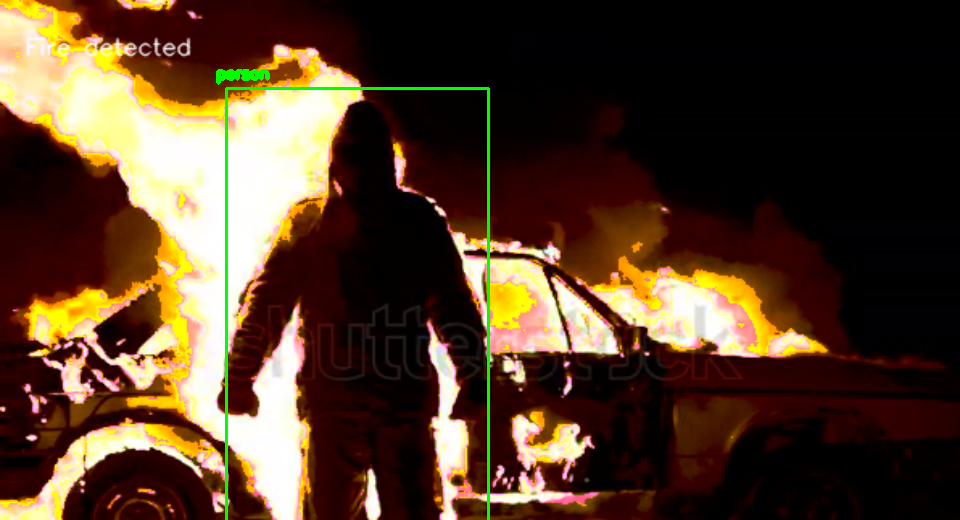

Warning!! Human and Fire is detected :high priority region


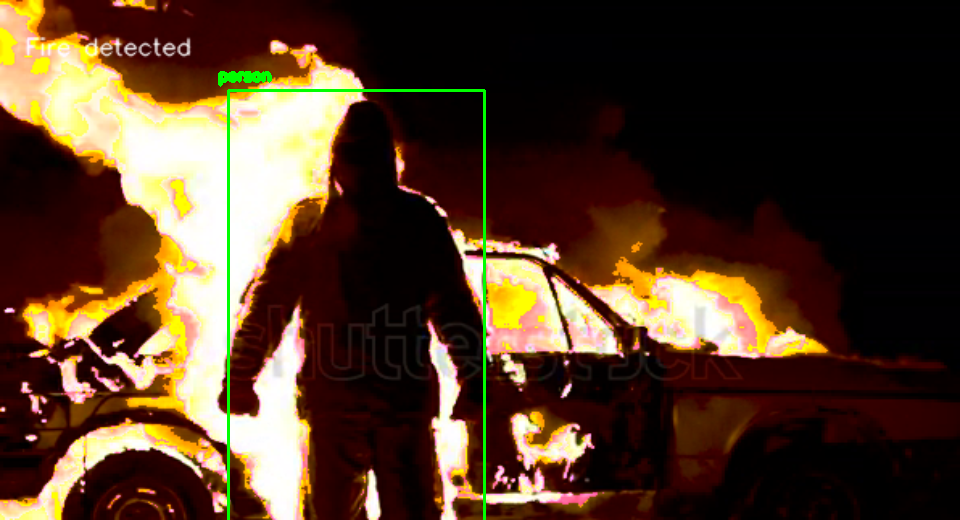

Warning!! Human and Fire is detected :high priority region


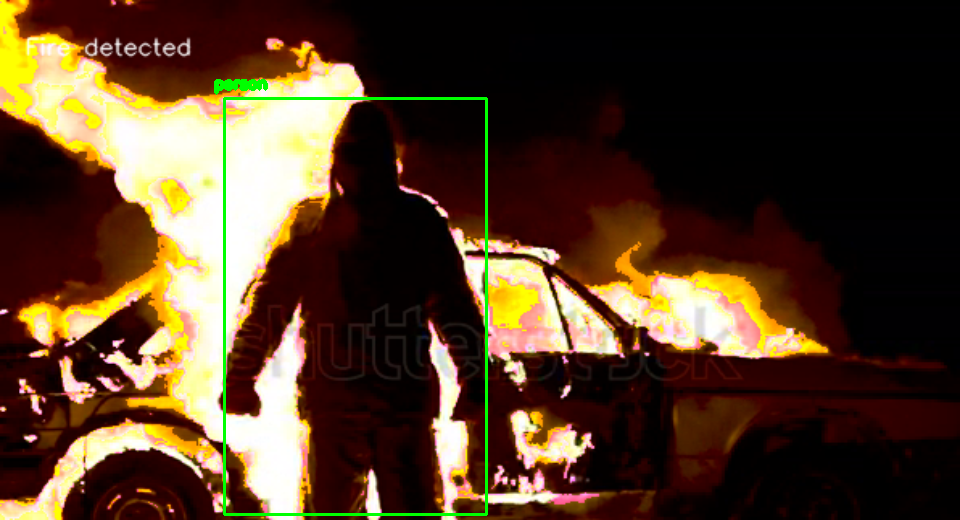

Warning!! Human and Fire is detected :high priority region


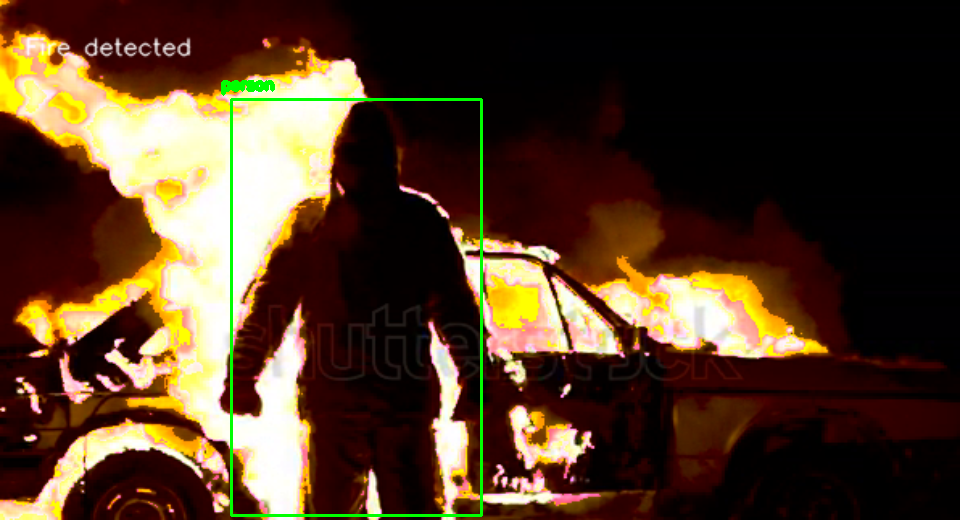

Warning!! Human and Fire is detected :high priority region


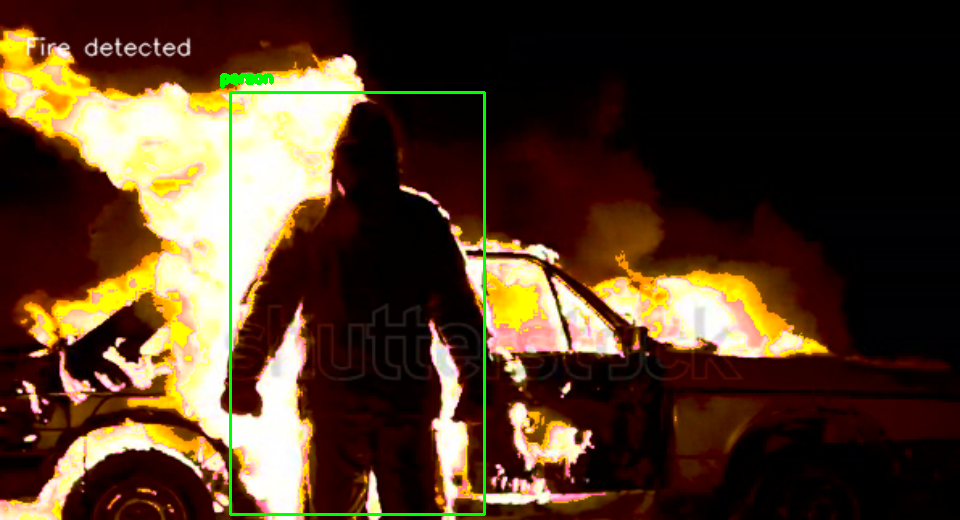

Warning!! Human and Fire is detected :high priority region


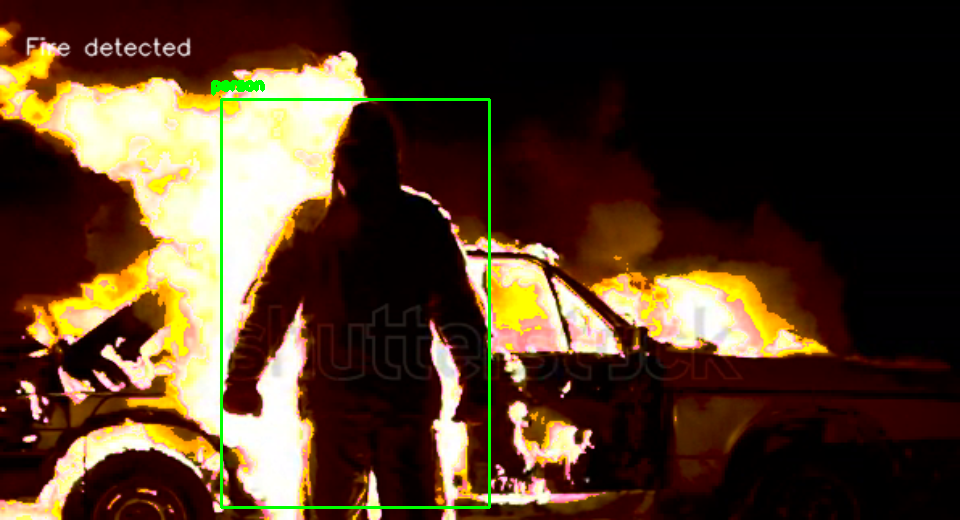

Warning!! Human and Fire is detected :high priority region


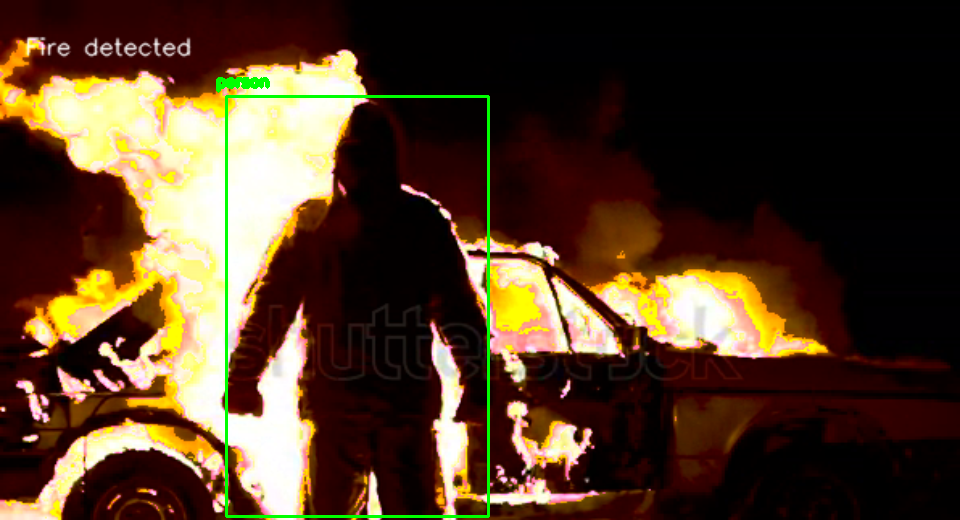

Warning!! Human and Fire is detected :high priority region


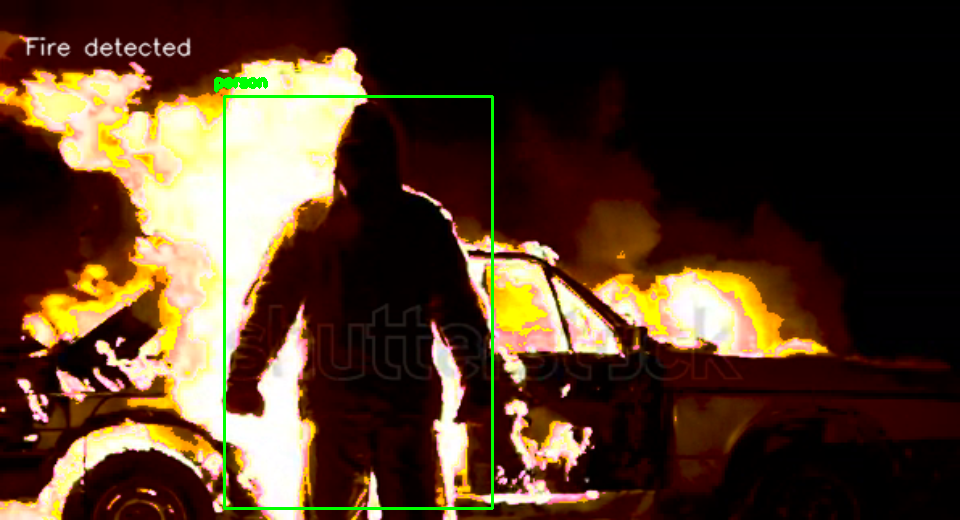

Warning!! Human and Fire is detected :high priority region


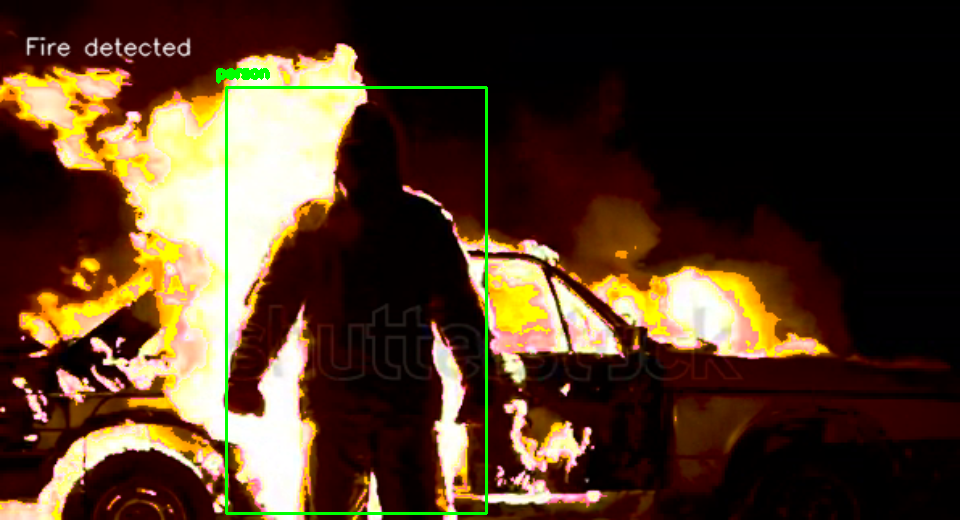

Warning!! Human and Fire is detected :high priority region


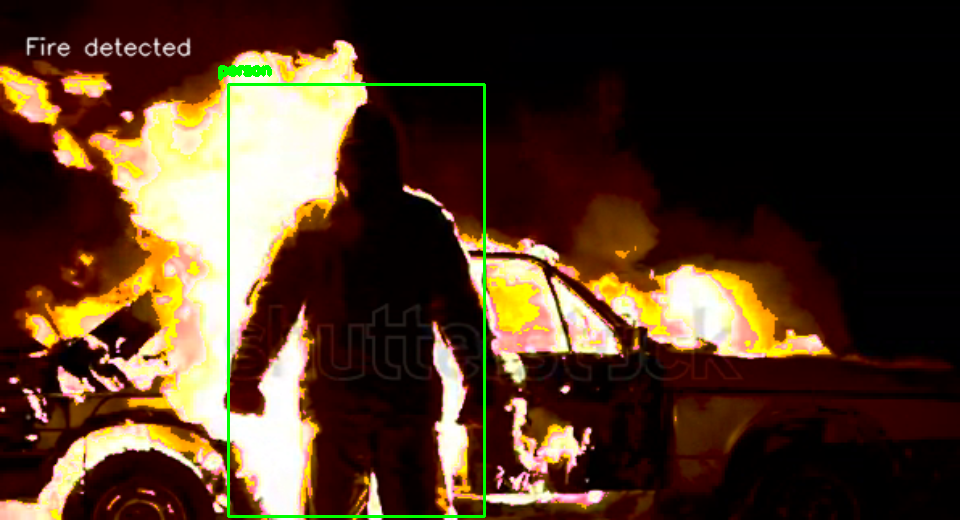

Warning!! Human and Fire is detected :high priority region


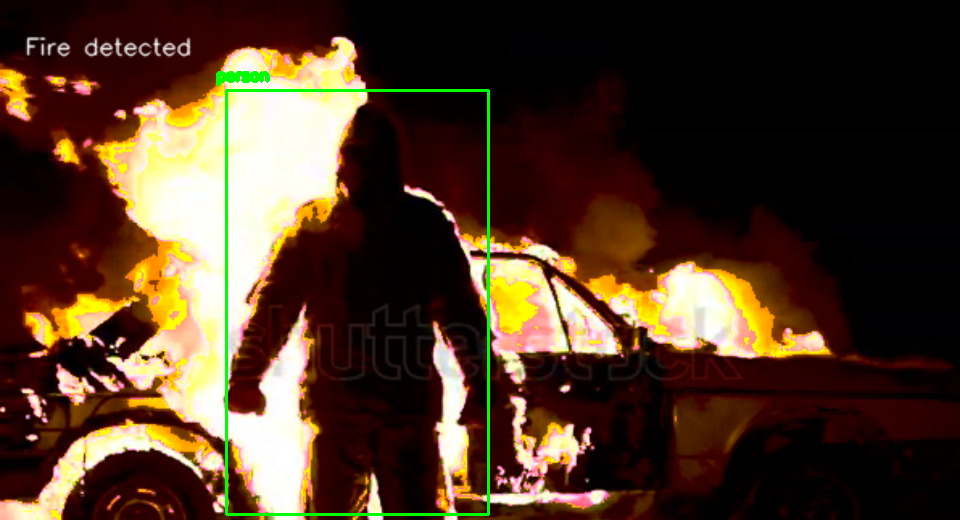

Warning!! Human and Fire is detected :high priority region


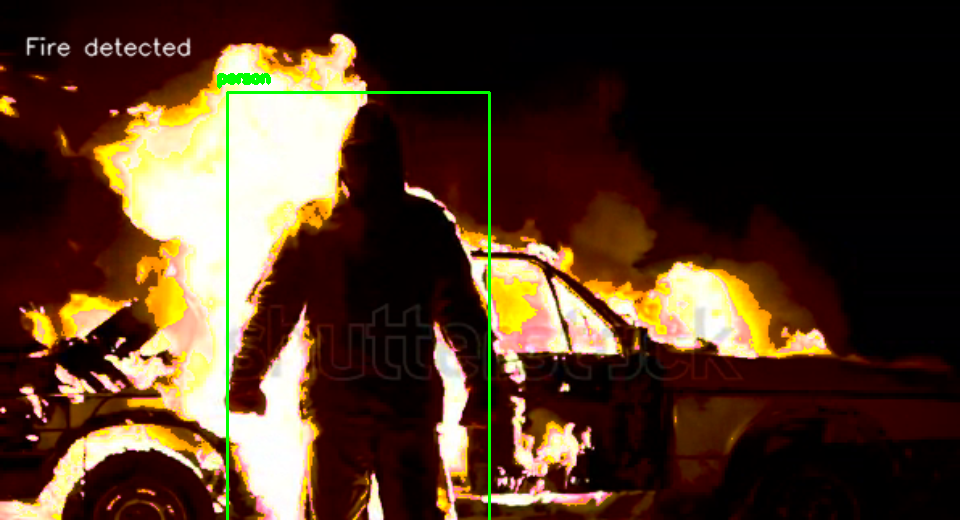

Warning!! Human and Fire is detected :high priority region


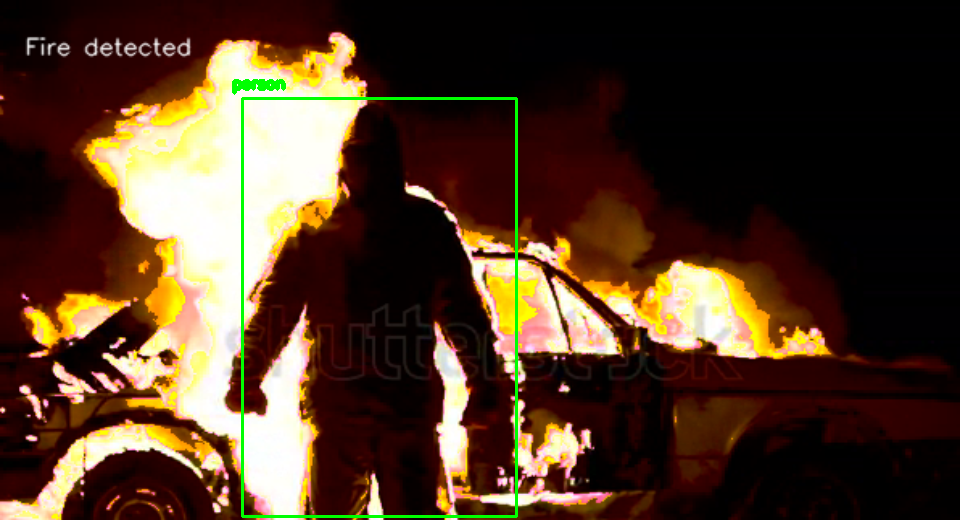

Warning!! Human and Fire is detected :high priority region


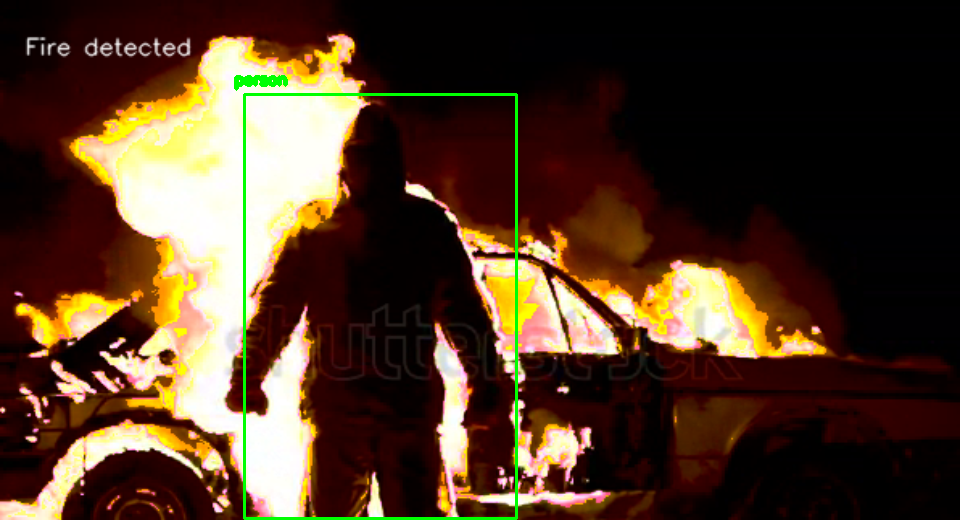

Warning!! Human and Fire is detected :high priority region


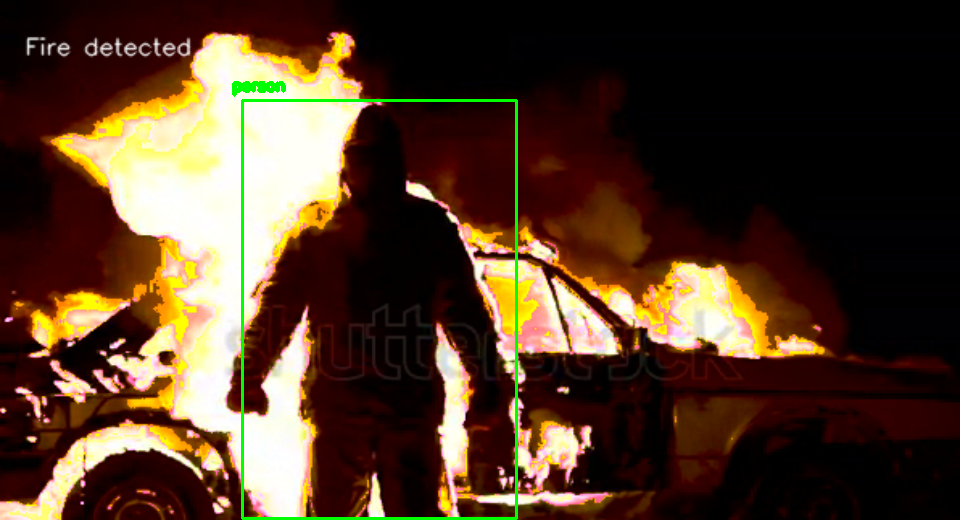

Warning!! Human and Fire is detected :high priority region


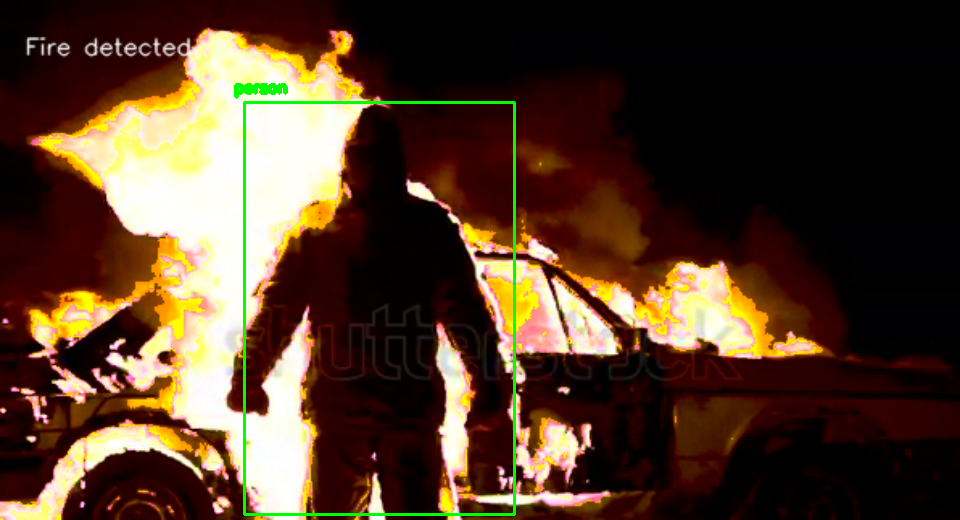

Warning!! Human and Fire is detected :high priority region


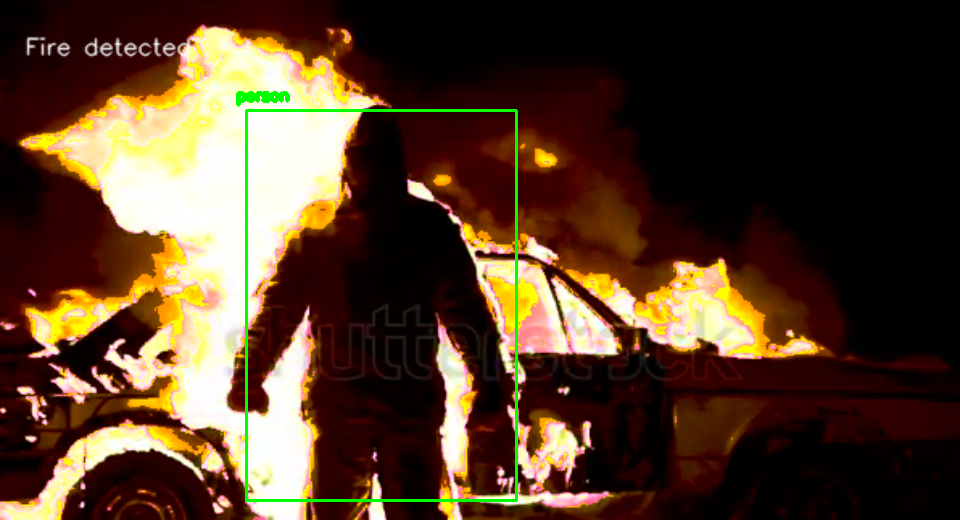

Warning!! Human and Fire is detected :high priority region


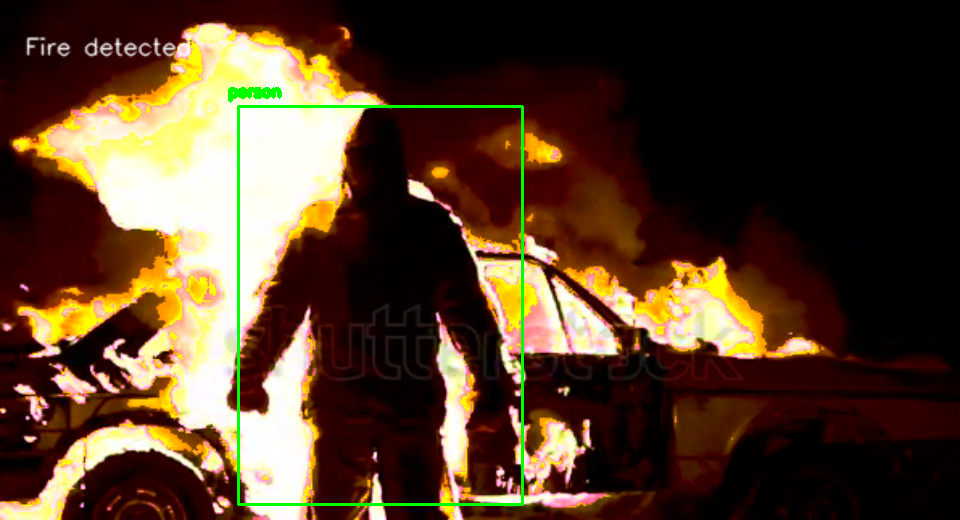

Warning!! Human and Fire is detected :high priority region


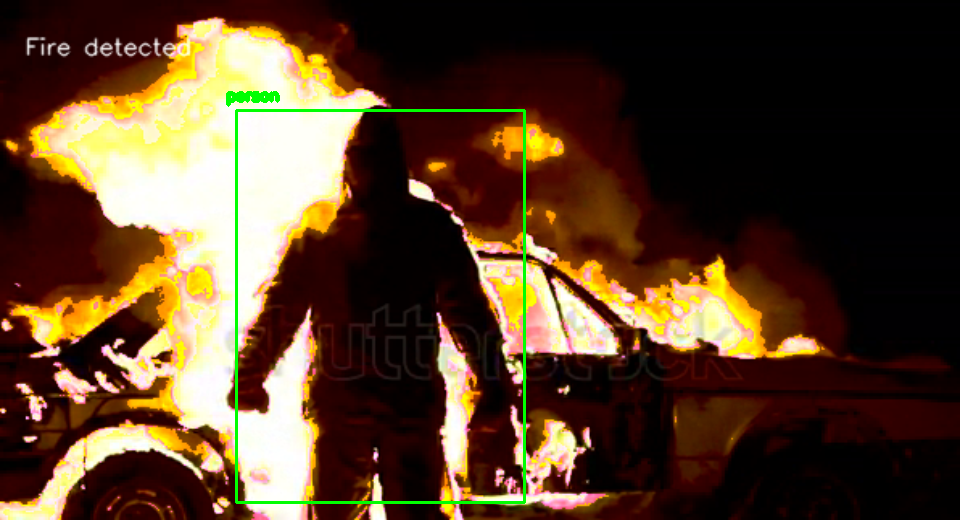

Warning!! Human and Fire is detected :high priority region


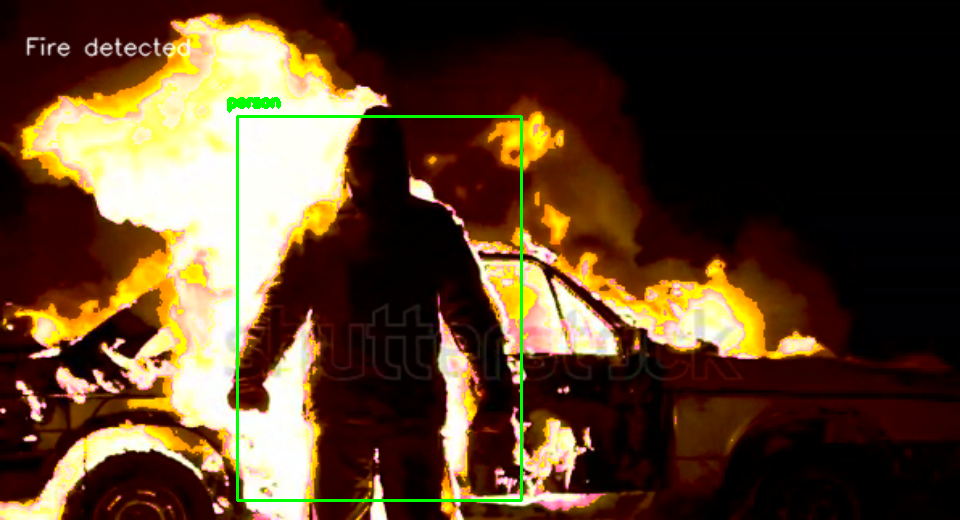

Warning!! Human and Fire is detected :high priority region


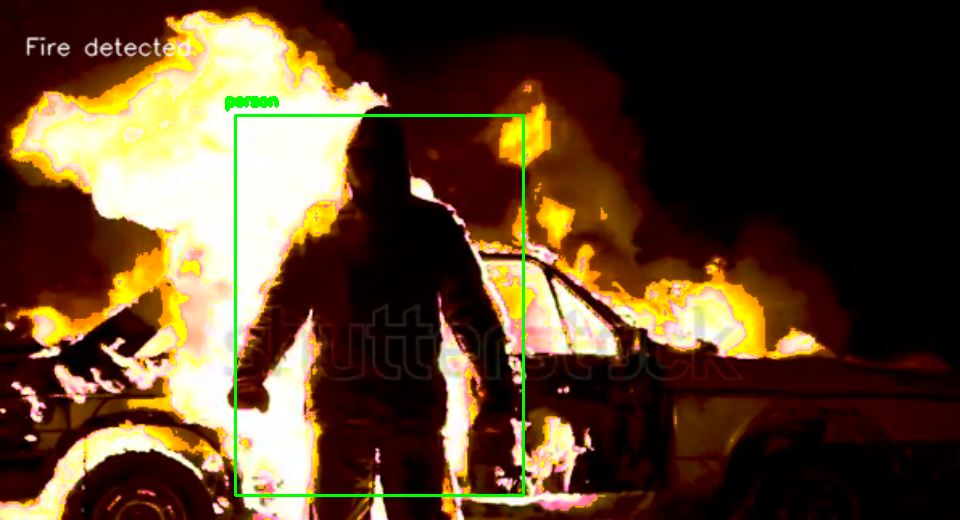

Warning!! Human and Fire is detected :high priority region


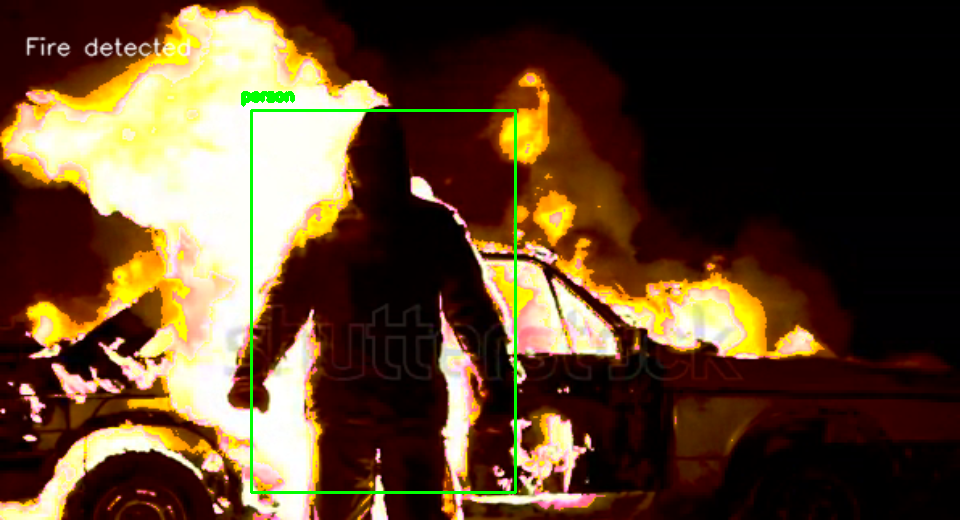

Warning!! Human and Fire is detected :high priority region


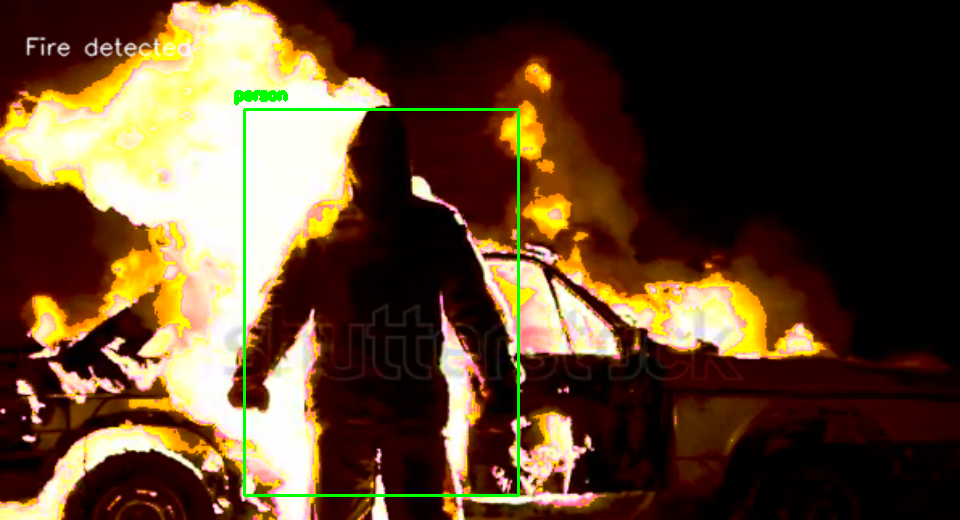

Warning!! Human and Fire is detected :high priority region


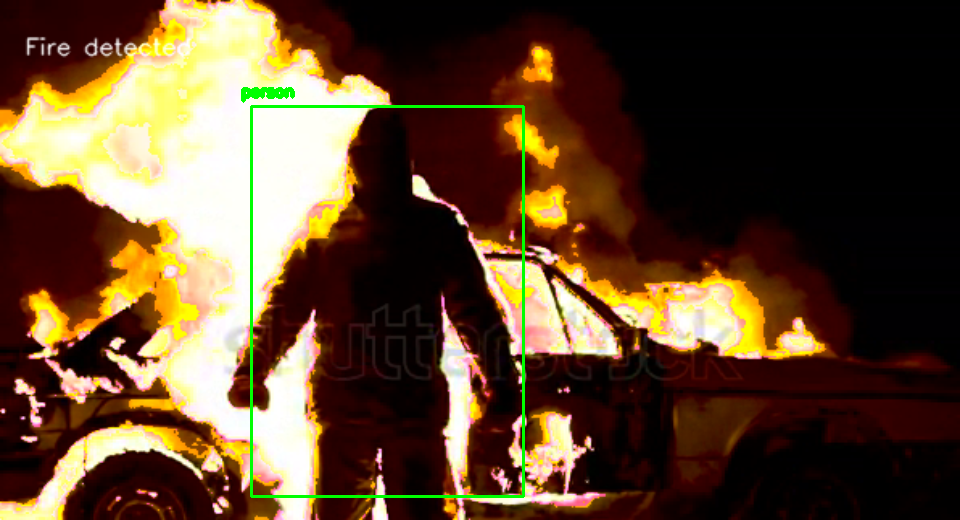

Warning!! Human and Fire is detected :high priority region


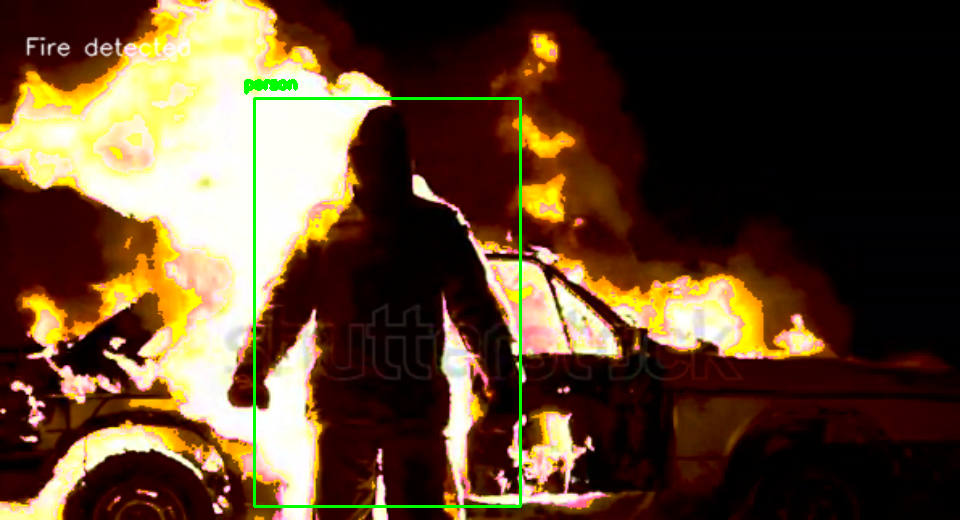

Warning!! Human and Fire is detected :high priority region


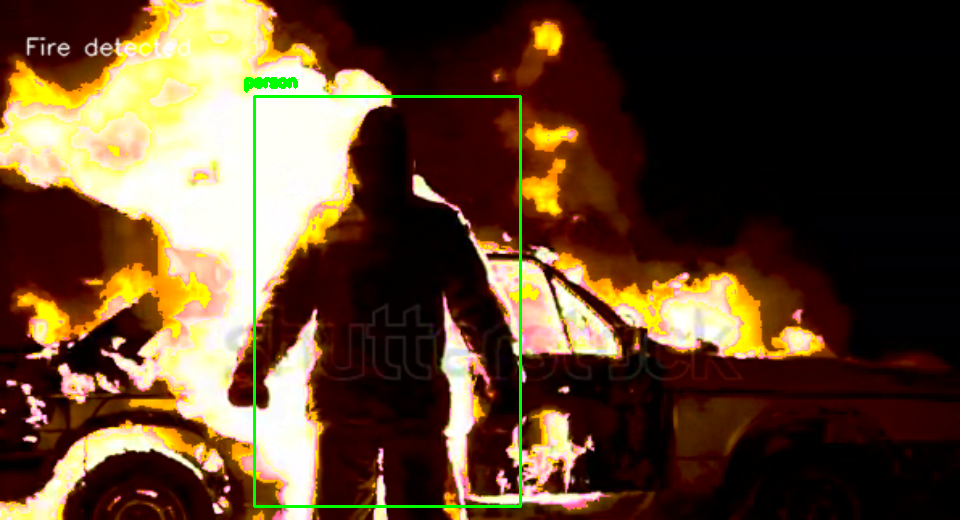

Warning!! Human and Fire is detected :high priority region


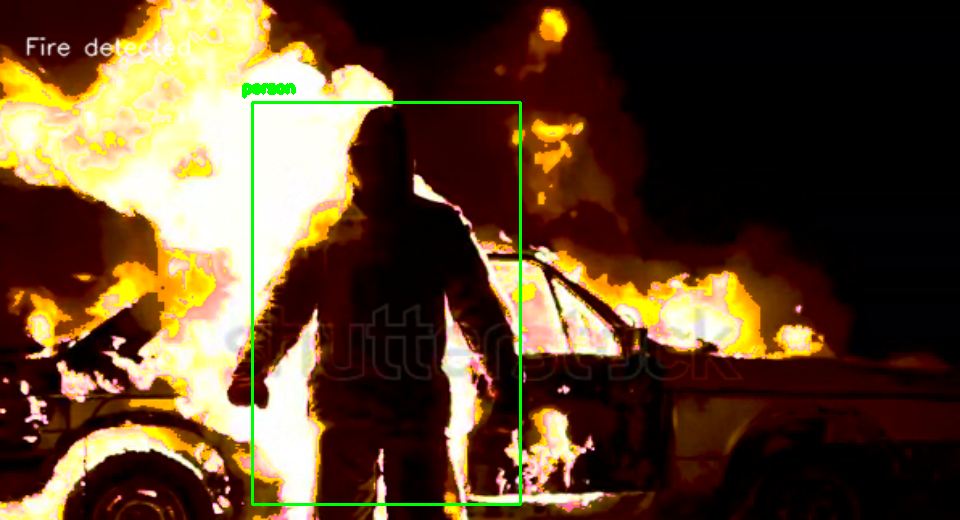

Warning!! Human and Fire is detected :high priority region


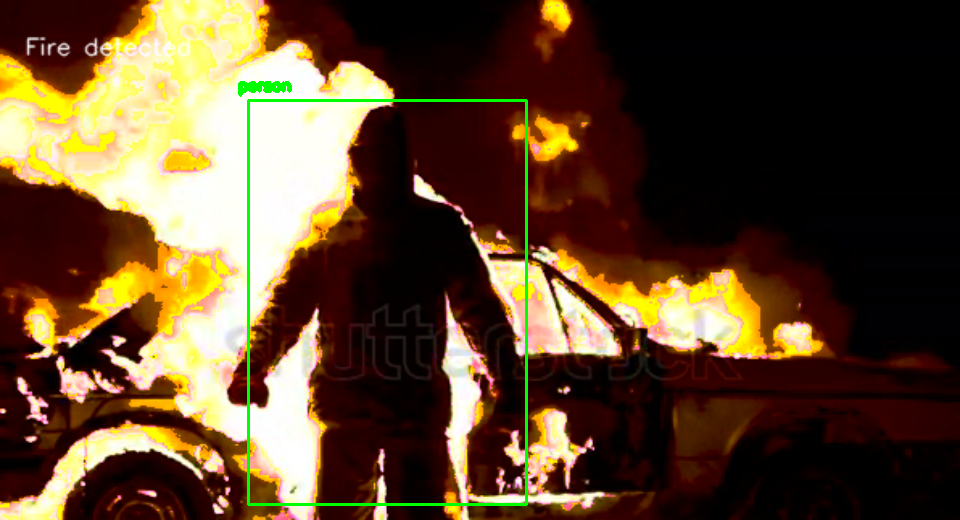

Warning!! Human and Fire is detected :high priority region


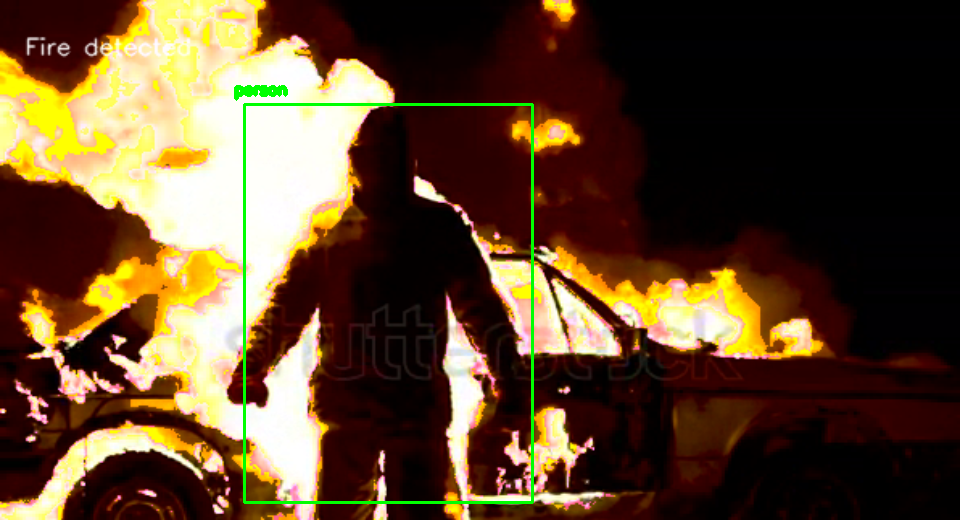

Warning!! Human and Fire is detected :high priority region


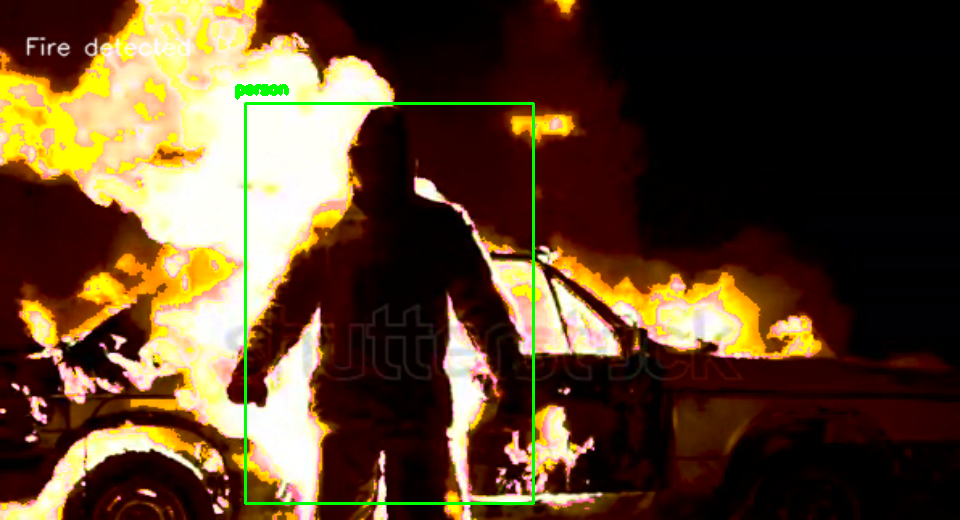

Warning!! Human and Fire is detected :high priority region


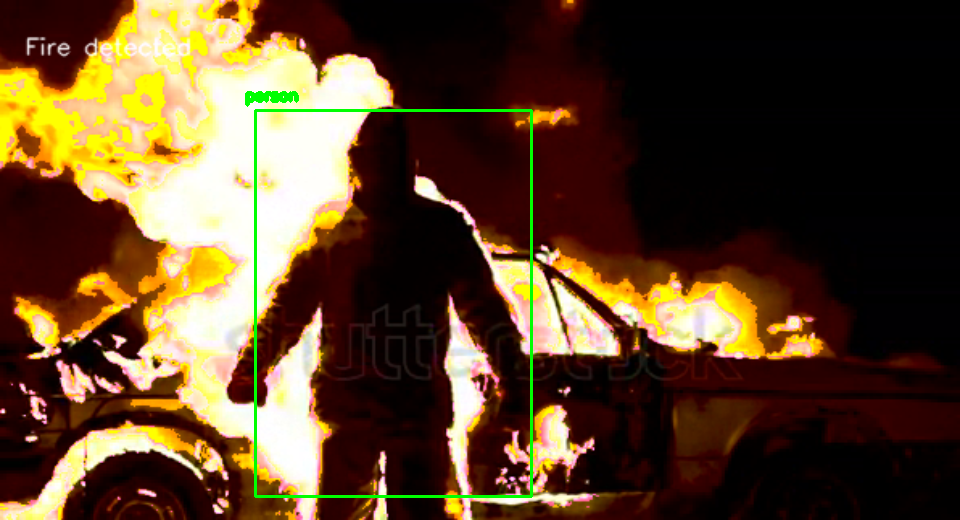

KeyboardInterrupt: ignored

In [ ]:
import numpy as np 
import imutils
import joblib
import cv2
from google.colab.patches import cv2_imshow
import os 
import matplotlib.pyplot as plt


def get_output_layers(net):
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]
    return output_layers

# function to draw bounding box on the detected object with class name
def draw_bounding_box(img, class_id, confidence, x, y, x_plus_w, y_plus_h):
    label = str(classes[class_id])
    if(label=='person'):
        cv2.rectangle(img, (x,y), (x_plus_w,y_plus_h), (0,255,0), 2)
        cv2.putText(img, label, (x-10,y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5,(0,255,0) , 3)

def sliding_window(image, window_size, step_size):
    '''
    This function returns a patch of the input 'image' of size 
    equal to 'window_size'. The first image returned top-left 
    co-ordinate (0, 0) and are increment in both x and y directions
    by the 'step_size' supplied.

    So, the input parameters are-
    image - Input image
    window_size - Size of Sliding Window 
    step_size - incremented Size of Window

    The function returns a tuple -
    (x, y, im_window)
    '''
    for y in range(0, image.shape[0], step_size[1]):
        for x in range(0, image.shape[1], step_size[0]):
            yield (x, y, image[y: y + window_size[1], x: x + window_size[0]])


        

classes = []
with open(class_name_path) as f:
  classes = f.read().splitlines()
scale = 0.00392
net = cv2.dnn.readNet(model_weight_path, model_cfb_path)




#Reading Video file from given Path
cap=cv2.VideoCapture(input_video_file_path)


#Loding the svm model
model = cv2.ml.SVM_load(svm_model_path)


#Reading video frame by frame
while True:
    ret,frame=cap.read() 
    if ret==False:
        break  
    im = imutils.resize(frame, width = min(400, frame.shape[1]))
    min_wdw_sz = (64, 128)
    step_size = (10, 10)
    downscale = 1.25
   
    img1= frame
    rchannel = img1[:, :, 2]
    gchannel = img1[:, :, 1]
    bchannel = img1[:, :, 0]
    
   
    Ydash = 16+(0.2567890625  * rchannel)+ (0.50412890625 * gchannel) +( 0.09790625 * bchannel)
    Cb= 128+(-0.14822265625 * rchannel)-(0.2909921875 * gchannel) + (0.43921484375* bchannel)
    Cr = 128+(0.43921484375  * rchannel)- (0.3677890625 * gchannel) -( 0.07142578125 * bchannel)
    
    Ymean=np.mean(np.mean(Ydash))
    Cbmean=np.mean(np.mean(Cb))
    Crmean=np.mean(np.mean(Cr))
    Crstd=np.std(Cr)
    
    #rule one starts here
    R1r, R1c= np.where(Ydash > Cb)
    ruleIpixel=len(R1r)
    Ir1= np.zeros(np.shape(img1), dtype='uint8')
    for i in range(ruleIpixel):
        Ir1[R1r[i],R1c[i],2] =rchannel[R1r[i],R1c[i]]
        Ir1[R1r[i],R1c[i],1] =gchannel[R1r[i],R1c[i]]
        Ir1[R1r[i],R1c[i],0] =bchannel[R1r[i],R1c[i]]
        i=i+1
    
    #rule 2 starts here
    R2r, R2c= (np.where((Ydash>Ymean) & (Cr> Crmean)))
    ruleIIpixel=len(R2r)
    Ir2=  np.zeros(np.shape(img1), dtype='uint8')
    for i2 in range(ruleIIpixel):
        Ir2[R2r[i2],R2c[i2],2] =rchannel[R2r[i2],R2c[i2]]
        Ir2[R2r[i2],R2c[i2],1] =gchannel[R2r[i2],R2c[i2]]
        Ir2[R2r[i2],R2c[i2],0] =bchannel[R2r[i2],R2c[i2]]
        i2=i2+1
        
    #rule one and two
    R12r, R12c= np.where((Ydash>Cb) & (Ydash>Ymean) & (Cr > Crmean))
    ruleI_IIpixel=len(R12r)
    Ir12= np.zeros(np.shape(img1), dtype='uint8')
    for i3 in range(ruleI_IIpixel):
        Ir12[R12r[i3],R12c[i3],2] =rchannel[R12r[i3],R12c[i3]]
        Ir12[R12r[i3],R12c[i3],1] =gchannel[R12r[i3],R12c[i3]]
        Ir12[R12r[i3],R12c[i3],0] =bchannel[R12r[i3],R12c[i3]]
        i3=i3+1
    
    #rule three
    R3r, R3c= np.where((Ydash>Cr) & (Cb>Cr) )
    ruleIIIpixel=len(R3r)
    Ir3= np.zeros(np.shape(img1), dtype='uint8')
    for i4 in range(ruleIIIpixel):
        Ir3[R3r[i4],R3c[i4],2] =rchannel[R3r[i4],R3c[i4]]
        Ir3[R3r[i4],R3c[i4],1] =gchannel[R3r[i4],R3c[i4]]
        Ir3[R3r[i4],R3c[i4],0] =bchannel[R3r[i4],R3c[i4]]
        i4=i4+1
    
    #rule four
    R4r, R4c= np.where((Cr<(7.4*Crstd)))
    ruleIVpixel=len(R4r)
    Ir4=  np.zeros(np.shape(img1), dtype='uint8')
    for i5 in range(ruleIVpixel):
        Ir4[R4r[i5],R4c[i5],2] =rchannel[R4r[i5],R4c[i5]]
        Ir4[R4r[i5],R4c[i5],1] =gchannel[R4r[i5],R4c[i5]]
        Ir4[R4r[i5],R4c[i5],0] =bchannel[R4r[i5],R4c[i5]]
        i5=i5+1
    
    #rule three and four
    R6r, R6c= np.where((Ydash>Cr) & (Cb> Cr) & (Cr<(7.4*Crstd)))
    ruleVIpixel=len(R6r)
    Ir6= np.zeros(np.shape(img1), dtype='uint8')
    for i6 in range(ruleVIpixel):
        Ir6[R6r[i6],R6c[i6],2] =rchannel[R6r[i6],R6c[i6]]
        Ir6[R6r[i6],R6c[i6],1] =gchannel[R6r[i6],R6c[i6]]
        Ir6[R6r[i6],R6c[i6],0] =bchannel[R6r[i6],R6c[i6]]
        i6=i6+1
    
    f_f = cv2.add(Ir12,Ir6)


    R7r, R7c = np.where( (f_f[:,:,1] > f_f[:,:,0] ) & ( f_f[:,:,1] > f_f[:,:,0]) & (f_f[:,:,0 ]< 100))
    rows, columns = np.shape(img1[:,:,2])
    #columns = len(img1[:,:,0])
    blank=f_f
    blank[np.where((blank == [255,255,255]).all(axis = 2) | (blank != [0,0,0]).all(axis = 2) )] = [128,0,128]

    ff_c= 1
    ff_r=len(R7r)
    show = ""
    if ff_r > ( rows*columns*2/100):
       fdet=cv2.putText(frame,"Fire detected ", (15, 35), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1,lineType=cv2.LINE_AA)
       fdet=cv2.add(fdet,blank)
       fdet=cv2.resize(fdet, (960, 520))
       show = fdet
       blank=cv2.putText(blank,"Fire detected ", (15, 35), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255),1, lineType=cv2.LINE_AA)
       blank=cv2.resize(blank, (960, 520))
       #cv2_imshow(blank)
       fire=True
           
    else:
         Ifinal= np.zeros(np.shape(img1), dtype='uint8')
         fnd=cv2.putText(frame,"Fire NOT detected ", (15, 35), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1,lineType=cv2.LINE_AA)
         fnd=cv2.resize(fnd, (960, 520))
         show = fnd
         fire=False
    # fire detecton code ends here
    # print(fire)
    #List to store the human detections
    blob = cv2.dnn.blobFromImage(show, scale, (416,416), (0,0,0), True, crop=False)
    net.setInput(blob)
    Width = show.shape[1]
    Height = show.shape[0]
    outs = net.forward(get_output_layers(net))

    # initialization
    class_ids = []
    confidences = []
    boxes = []
    conf_threshold = 0.5
    nms_threshold = 0.4

    # for each detetion from each output layer 
    # get the confidence, class id, bounding box params
    # and ignore weak detections (confidence < 0.5)
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detection[0] * Width)
                center_y = int(detection[1] * Height)
                w = int(detection[2] * Width)
                h = int(detection[3] * Height)
                x = center_x - w / 2
                y = center_y - h / 2
                class_ids.append(class_id)
                confidences.append(float(confidence))
                boxes.append([x, y, w, h])
    indices = cv2.dnn.NMSBoxes(boxes, confidences, conf_threshold, nms_threshold)
    fnh = len(indices)
    if(fire and fnh>0):
      print("Warning!! Human and Fire is detected :high priority region")
    elif(fire):
      print("Fire is detected but Human is absent :less priority region")
      # go through the detections remaining
      # after nms and draw bounding box
    for i in indices:
        i = i[0]
        box = boxes[i]
        x = box[0]
        y = box[1]
        w = box[2]
        h = box[3]  
        draw_bounding_box(show, class_ids[i], confidences[i], round(x), round(y), round(x+w), round(y+h))

      # display output image    
    cv2_imshow(show)

# wait until any key is presed
cv2.waitKey(1)
# release resources
cv2.destroyAllWindows()

    

##Input: Image folder Path

In [ ]:
input_folder_path = "/content/drive/MyDrive/Data/test_image"

In [ ]:
import os
os.chdir(input_folder_path)
i = 1
for file in os.listdir():
    os.rename(file,f'Fire{i}.jpg')
    i+=1
os.listdir()

['Fire1.jpg',
 'Fire2.jpg',
 'Fire3.jpg',
 'Fire4.jpg',
 'Fire5.jpg',
 'Fire6.jpg',
 'Fire7.jpg',
 'Fire8.jpg',
 'Fire9.jpg',
 'Fire10.jpg',
 'Fire11.jpg',
 'Fire12.jpg',
 'Fire13.jpg',
 'Fire14.jpg',
 'Fire15.jpg',
 'Fire16.jpg',
 'Fire17.jpg',
 'Fire18.jpg',
 'Fire19.jpg',
 'Fire20.jpg',
 'Fire21.jpg',
 'Fire22.jpg',
 'Fire23.jpg',
 'Fire24.jpg',
 'Fire25.jpg',
 'Fire26.jpg',
 'Fire27.jpg',
 'Fire28.jpg',
 'Fire29.jpg',
 'Fire30.jpg',
 'Fire31.jpg',
 'Fire32.jpg',
 'Fire33.jpg',
 'Fire34.jpg',
 'Fire35.jpg',
 'Fire36.jpg',
 'Fire37.jpg',
 'Fire38.jpg',
 'Fire39.jpg',
 'Fire40.jpg',
 'Fire41.jpg',
 'Fire42.jpg',
 'Fire43.jpg',
 'Fire44.jpg',
 'Fire45.jpg',
 'Fire46.jpg',
 'Fire47.jpg',
 'Fire48.jpg',
 'Fire49.jpg',
 'Fire50.jpg',
 'Fire51.jpg',
 'Fire52.jpg']

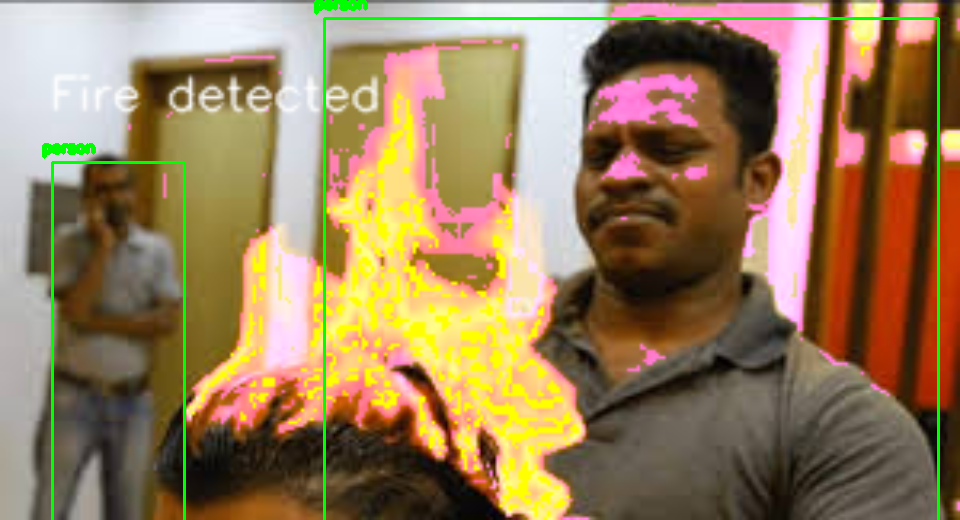

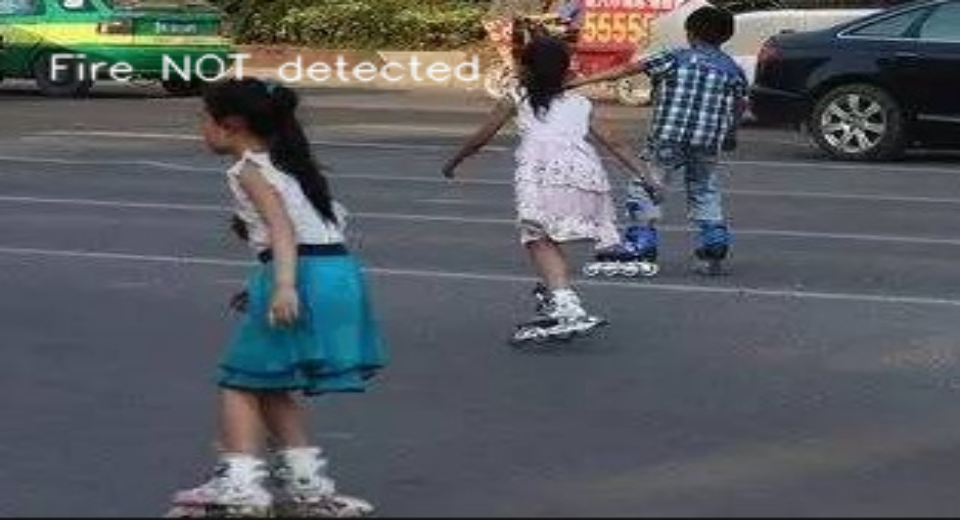

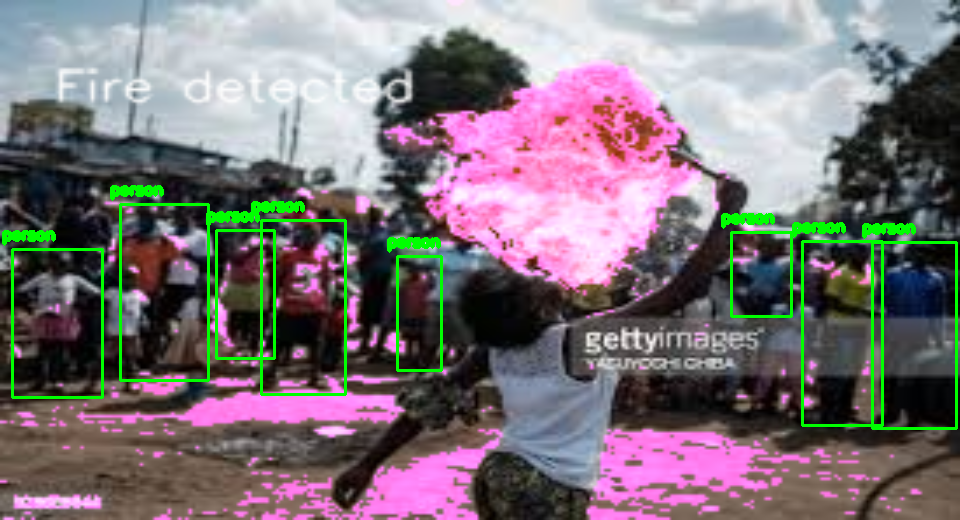

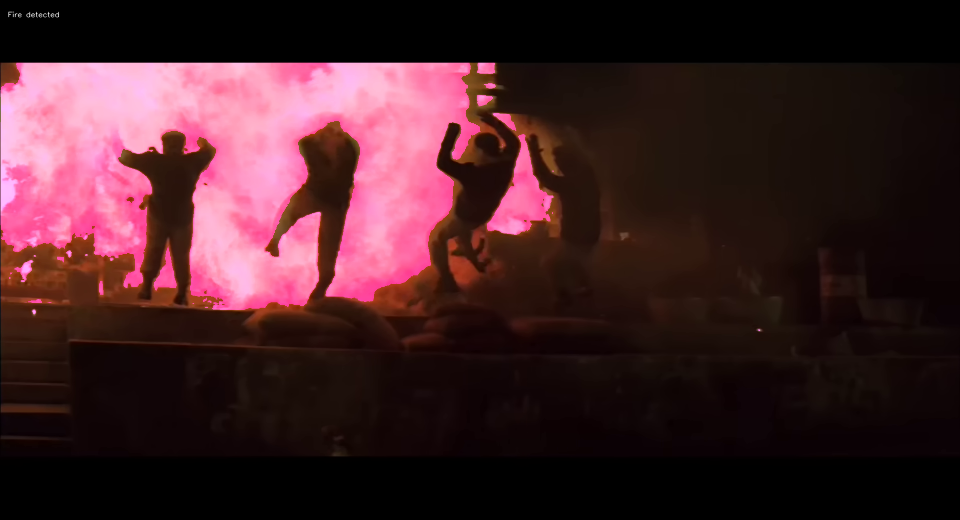

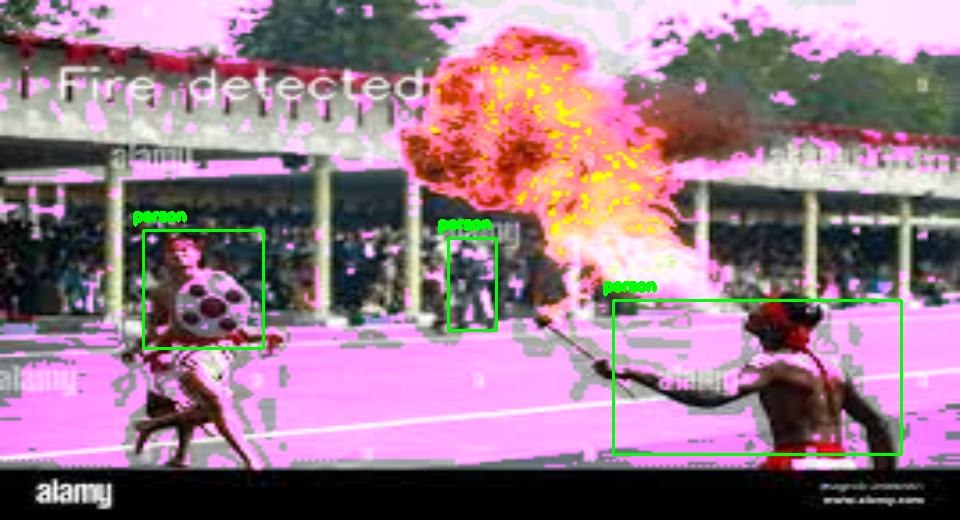

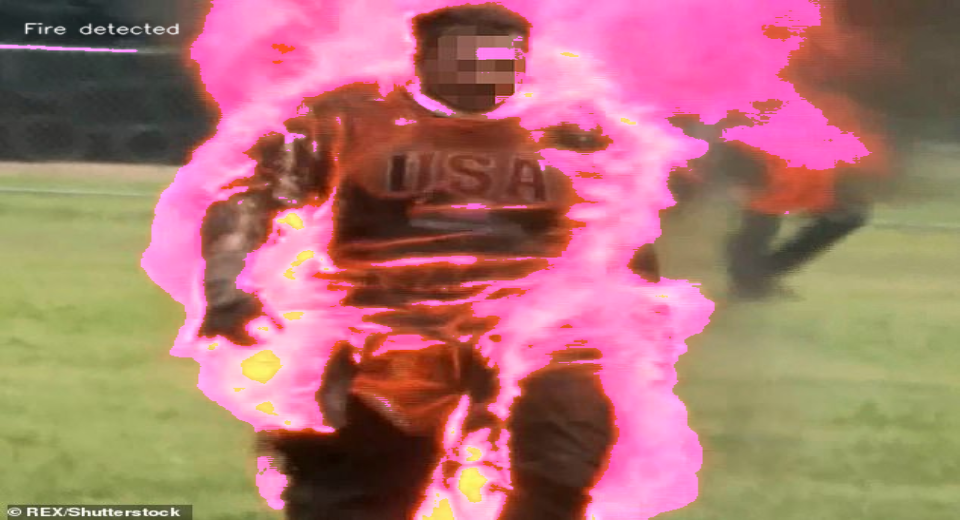

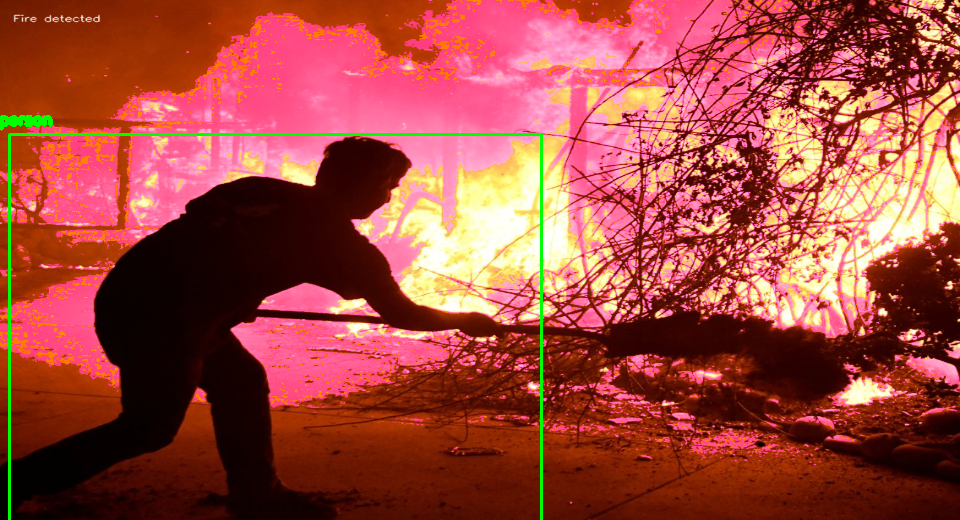

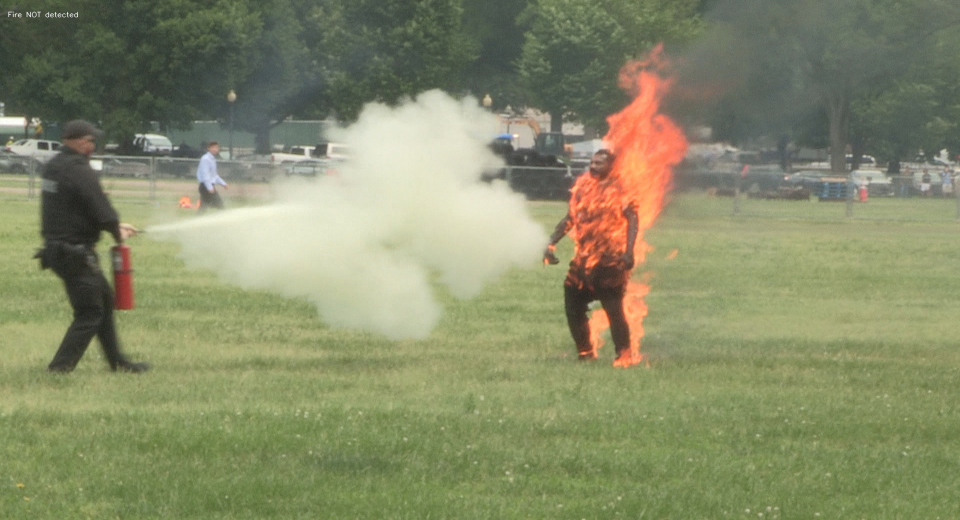

KeyboardInterrupt: ignored

In [ ]:
import numpy as np 
import imutils
import joblib
import cv2
from google.colab.patches import cv2_imshow
import os 
import matplotlib.pyplot as plt


def get_output_layers(net):
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]
    return output_layers

# function to draw bounding box on the detected object with class name
def draw_bounding_box(img, class_id, confidence, x, y, x_plus_w, y_plus_h):
    label = str(classes[class_id])
    if(label=='person'):
        cv2.rectangle(img, (x,y), (x_plus_w,y_plus_h), (0,255,0), 2)
        cv2.putText(img, label, (x-10,y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5,(0,255,0) , 3)

def sliding_window(image, window_size, step_size):
    '''
    This function returns a patch of the input 'image' of size 
    equal to 'window_size'. The first image returned top-left 
    co-ordinate (0, 0) and are increment in both x and y directions
    by the 'step_size' supplied.

    So, the input parameters are-
    image - Input image
    window_size - Size of Sliding Window 
    step_size - incremented Size of Window

    The function returns a tuple -
    (x, y, im_window)
    '''
    for y in range(0, image.shape[0], step_size[1]):
        for x in range(0, image.shape[1], step_size[0]):
            yield (x, y, image[y: y + window_size[1], x: x + window_size[0]])


            
classes = []
with open(class_name_path) as f:
  classes = f.read().splitlines()
scale = 0.00392
net = cv2.dnn.readNet(model_weight_path, model_cfb_path)
for file_name in os.listdir(input_folder_path):
    # ret,frame=cap.read() 
    file_path = input_folder_path+"/"+file_name
    frame = cv2.imread(file_path)
    im = imutils.resize(frame, width = min(400, frame.shape[1]))
    min_wdw_sz = (64, 128)
    step_size = (10, 10)
    downscale = 1.25
   
    img1= frame
    rchannel = img1[:, :, 2]
    gchannel = img1[:, :, 1]
    bchannel = img1[:, :, 0]
    
   
    Ydash = 16+(0.2567890625  * rchannel)+ (0.50412890625 * gchannel) +( 0.09790625 * bchannel)
    Cb= 128+(-0.14822265625 * rchannel)-(0.2909921875 * gchannel) + (0.43921484375* bchannel)
    Cr = 128+(0.43921484375  * rchannel)- (0.3677890625 * gchannel) -( 0.07142578125 * bchannel)
    
    Ymean=np.mean(np.mean(Ydash))
    Cbmean=np.mean(np.mean(Cb))
    Crmean=np.mean(np.mean(Cr))
    Crstd=np.std(Cr)
    
    #rule one starts here
    R1r, R1c= np.where(Ydash > Cb)
    ruleIpixel=len(R1r)
    Ir1= np.zeros(np.shape(img1), dtype='uint8')
    for i in range(ruleIpixel):
        Ir1[R1r[i],R1c[i],2] =rchannel[R1r[i],R1c[i]]
        Ir1[R1r[i],R1c[i],1] =gchannel[R1r[i],R1c[i]]
        Ir1[R1r[i],R1c[i],0] =bchannel[R1r[i],R1c[i]]
        i=i+1
    
    #rule 2 starts here
    R2r, R2c= (np.where((Ydash>Ymean) & (Cr> Crmean)))
    ruleIIpixel=len(R2r)
    Ir2=  np.zeros(np.shape(img1), dtype='uint8')
    for i2 in range(ruleIIpixel):
        Ir2[R2r[i2],R2c[i2],2] =rchannel[R2r[i2],R2c[i2]]
        Ir2[R2r[i2],R2c[i2],1] =gchannel[R2r[i2],R2c[i2]]
        Ir2[R2r[i2],R2c[i2],0] =bchannel[R2r[i2],R2c[i2]]
        i2=i2+1
        
    #rule one and two
    R12r, R12c= np.where((Ydash>Cb) & (Ydash>Ymean) & (Cr > Crmean))
    ruleI_IIpixel=len(R12r)
    Ir12= np.zeros(np.shape(img1), dtype='uint8')
    for i3 in range(ruleI_IIpixel):
        Ir12[R12r[i3],R12c[i3],2] =rchannel[R12r[i3],R12c[i3]]
        Ir12[R12r[i3],R12c[i3],1] =gchannel[R12r[i3],R12c[i3]]
        Ir12[R12r[i3],R12c[i3],0] =bchannel[R12r[i3],R12c[i3]]
        i3=i3+1
    
    #rule three
    R3r, R3c= np.where((Ydash>Cr) & (Cb>Cr) )
    ruleIIIpixel=len(R3r)
    Ir3= np.zeros(np.shape(img1), dtype='uint8')
    for i4 in range(ruleIIIpixel):
        Ir3[R3r[i4],R3c[i4],2] =rchannel[R3r[i4],R3c[i4]]
        Ir3[R3r[i4],R3c[i4],1] =gchannel[R3r[i4],R3c[i4]]
        Ir3[R3r[i4],R3c[i4],0] =bchannel[R3r[i4],R3c[i4]]
        i4=i4+1
    
    #rule four
    R4r, R4c= np.where((Cr<(7.4*Crstd)))
    ruleIVpixel=len(R4r)
    Ir4=  np.zeros(np.shape(img1), dtype='uint8')
    for i5 in range(ruleIVpixel):
        Ir4[R4r[i5],R4c[i5],2] =rchannel[R4r[i5],R4c[i5]]
        Ir4[R4r[i5],R4c[i5],1] =gchannel[R4r[i5],R4c[i5]]
        Ir4[R4r[i5],R4c[i5],0] =bchannel[R4r[i5],R4c[i5]]
        i5=i5+1
    
    #rule three and four
    R6r, R6c= np.where((Ydash>Cr) & (Cb> Cr) & (Cr<(7.4*Crstd)))
    ruleVIpixel=len(R6r)
    Ir6= np.zeros(np.shape(img1), dtype='uint8')
    for i6 in range(ruleVIpixel):
        Ir6[R6r[i6],R6c[i6],2] =rchannel[R6r[i6],R6c[i6]]
        Ir6[R6r[i6],R6c[i6],1] =gchannel[R6r[i6],R6c[i6]]
        Ir6[R6r[i6],R6c[i6],0] =bchannel[R6r[i6],R6c[i6]]
        i6=i6+1
    
    f_f = cv2.add(Ir12,Ir6)


    R7r, R7c = np.where( (f_f[:,:,1] > f_f[:,:,0] ) & ( f_f[:,:,1] > f_f[:,:,0]) & (f_f[:,:,0 ]< 100))
    rows, columns = np.shape(img1[:,:,2])
    #columns = len(img1[:,:,0])
    blank=f_f
    blank[np.where((blank == [255,255,255]).all(axis = 2) | (blank != [0,0,0]).all(axis = 2) )] = [128,0,128]

    ff_c= 1
    ff_r=len(R7r)
    show = ""
    if ff_r > ( rows*columns*2/100):
       fdet=cv2.putText(frame,"Fire detected ", (15, 35), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1,lineType=cv2.LINE_AA)
       fdet=cv2.add(fdet,blank)
       fdet=cv2.resize(fdet, (960, 520))
       show = fdet
       blank=cv2.putText(blank,"Fire detected ", (15, 35), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255),1, lineType=cv2.LINE_AA)
       blank=cv2.resize(blank, (960, 520))
       #cv2_imshow(blank)
       fire=True
           
    else:
         Ifinal= np.zeros(np.shape(img1), dtype='uint8')
         fnd=cv2.putText(frame,"Fire NOT detected ", (15, 35), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1,lineType=cv2.LINE_AA)
         fnd=cv2.resize(fnd, (960, 520))
         show = fnd
         fire=False
    # fire detecton code ends here
    if fire==False:
      cv2_imshow(show)
      cv2.imwrite(file_path, frame)
      continue
    #List to store the human detections
    blob = cv2.dnn.blobFromImage(show, scale, (416,416), (0,0,0), True, crop=False)
    net.setInput(blob)
    Width = show.shape[1]
    Height = show.shape[0]
    outs = net.forward(get_output_layers(net))

    # initialization
    class_ids = []
    confidences = []
    boxes = []
    conf_threshold = 0.5
    nms_threshold = 0.4

    # for each detetion from each output layer 
    # get the confidence, class id, bounding box params
    # and ignore weak detections (confidence < 0.5)
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detection[0] * Width)
                center_y = int(detection[1] * Height)
                w = int(detection[2] * Width)
                h = int(detection[3] * Height)
                x = center_x - w / 2
                y = center_y - h / 2
                class_ids.append(class_id)
                confidences.append(float(confidence))
                boxes.append([x, y, w, h])
    indices = cv2.dnn.NMSBoxes(boxes, confidences, conf_threshold, nms_threshold)
    fnh = len(indices)
    
      # go through the detections remaining
      # after nms and draw bounding box
    for i in indices:
        i = i[0]
        box = boxes[i]
        x = box[0]
        y = box[1]
        w = box[2]
        h = box[3]  
        draw_bounding_box(show, class_ids[i], confidences[i], round(x), round(y), round(x+w), round(y+h))

      # display output image    
    cv2_imshow(show)
    cv2.imwrite(file_path, frame)

# wait until any key is presed
cv2.waitKey(1)
    
 # save output image to disk


# release resources
cv2.destroyAllWindows()

    